<a href="https://colab.research.google.com/github/syenirasheila/Analysis_and_Prediction_of_Earthquakes_Indonesia_ProphetForecasting/blob/main/Analysis_and_Prediction_of_Earthquakes_Indonesia_ProphetForecasting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analisis dan Prediksi Gempa Bumi Indonesia Menggunakan Prophet Forecasting

## Pengumpulan Data

In [ ]:
!pip install prophet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#import library package
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import plotly.figure_factory as ff
import plotly.graph_objects as go
import numpy as np
import plotly.express as px
import re
import datetime as dt
from datetime import date
from datetime import timedelta
import gc
from tqdm import tqdm
from pylab import rcParams
from sklearn.metrics import mean_squared_error
from scipy.stats import probplot

import numpy as np
import pandas as pd
from prophet import Prophet
%matplotlib inline

In [ ]:
#koneksi google drive
from google.colab import drive

drive.mount("/content/MyDrive")

Mounted at /content/MyDrive


In [ ]:
data= pd.read_csv('/content/MyDrive/MyDrive/DS_118/Data_Gempa_Indonesia/katalog_gempa.csv')
data.head()

,tgl,ot,lat,lon,depth,mag,remark,strike1,dip1,rake1,strike2,dip2,rake2
0,2008/11/01,21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
1,2008/11/01,20:58:50.248,-6.55,129.64,10,4.6,Banda Sea,NaN,NaN,NaN,NaN,NaN,NaN
2,2008/11/01,17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
3,2008/11/01,16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
4,2008/11/01,16:20:37.327,-6.41,129.54,70,4.3,Banda Sea,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
data.tail()

,tgl,ot,lat,lon,depth,mag,remark,strike1,dip1,rake1,strike2,dip2,rake2
92882,2023/01/26,02:25:09.288,3.24,127.18,10,4.0,Talaud Islands - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN
92883,2023/01/26,02:15:03.893,2.70,127.10,10,3.9,Northern Molucca Sea,NaN,NaN,NaN,NaN,NaN,NaN
92884,2023/01/26,01:57:08.885,-7.83,121.07,10,3.8,Flores Sea,NaN,NaN,NaN,NaN,NaN,NaN
92885,2023/01/26,01:46:21.009,3.00,127.16,10,4.1,Northern Molucca Sea,NaN,NaN,NaN,NaN,NaN,NaN
92886,2023/01/26,00:00:35.181,-8.87,118.95,10,2.4,Sumbawa Region - Indonesia,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#cek row dan column
data.shape

(92887, 13)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92887 entries, 0 to 92886
Data columns (total 13 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   tgl      92887 non-null  object 
 1   ot       92887 non-null  object 
 2   lat      92887 non-null  float64
 3   lon      92887 non-null  float64
 4   depth    92887 non-null  int64  
 5   mag      92887 non-null  float64
 6   remark   92887 non-null  object 
 7   strike1  2735 non-null   float64
 8   dip1     2735 non-null   float64
 9   rake1    2735 non-null   float64
 10  strike2  2735 non-null   float64
 11  dip2     2735 non-null   float64
 12  rake2    2735 non-null   float64
dtypes: float64(9), int64(1), object(3)
memory usage: 9.2+ MB


## EDA

In [ ]:
#cek data yang kosong
data.isnull().sum()

tgl            0
ot             0
lat            0
lon            0
depth          0
mag            0
remark         0
strike1    90152
dip1       90152
rake1      90152
strike2    90152
dip2       90152
rake2      90152
dtype: int64

In [ ]:
#cek duplikasi data
print(data.duplicated().value_counts())

False    92887
dtype: int64


In [ ]:
#cek panjang objek data tanggal
lengths = data["tgl"].str.len()
lengths.value_counts()

10    92887
Name: tgl, dtype: int64

In [ ]:
#cek panjang objek data waktu
lengths = data["ot"].str.len()
lengths.value_counts()

12    92887
Name: ot, dtype: int64

In [ ]:
#drop fitur
data = data.drop(['strike1','dip1','rake1','strike2','dip2','rake2'], axis=1)
data.head()

,tgl,ot,lat,lon,depth,mag,remark
0,2008/11/01,21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia
1,2008/11/01,20:58:50.248,-6.55,129.64,10,4.6,Banda Sea
2,2008/11/01,17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia
3,2008/11/01,16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia
4,2008/11/01,16:20:37.327,-6.41,129.54,70,4.3,Banda Sea


In [ ]:
#membuat satu kolom untuk tanggal dan waktu
ot = pd.to_datetime(data['tgl'] + ' ' + data['ot'])
data['ot'] = ot
data.drop(['tgl'], axis=1, inplace=True)
data.head()

,ot,lat,lon,depth,mag,remark
0,2008-11-01 21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia
1,2008-11-01 20:58:50.248,-6.55,129.64,10,4.6,Banda Sea
2,2008-11-01 17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia
3,2008-11-01 16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia
4,2008-11-01 16:20:37.327,-6.41,129.54,70,4.3,Banda Sea


In [ ]:
#mengubah nama kolom
data.rename(columns = {'ot':'waktu_gempa', 'lat':'garis_lintang',
                     'lon':'garis_bujur', 'depth':'kedalaman_gempa',
                     'mag':'kekuatan_gempa', 'remark':'lokasi_gempa'}, inplace = True)
data.columns

Index(['waktu_gempa', 'garis_lintang', 'garis_bujur', 'kedalaman_gempa',
       'kekuatan_gempa', 'lokasi_gempa'],
      dtype='object')

In [ ]:
data

,waktu_gempa,garis_lintang,garis_bujur,kedalaman_gempa,kekuatan_gempa,lokasi_gempa
0,2008-11-01 21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia
1,2008-11-01 20:58:50.248,-6.55,129.64,10,4.6,Banda Sea
2,2008-11-01 17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia
3,2008-11-01 16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia
4,2008-11-01 16:20:37.327,-6.41,129.54,70,4.3,Banda Sea
...,...,...,...,...,...,...
92882,2023-01-26 02:25:09.288,3.24,127.18,10,4.0,Talaud Islands - Indonesia
92883,2023-01-26 02:15:03.893,2.70,127.10,10,3.9,Northern Molucca Sea
92884,2023-01-26 01:57:08.885,-7.83,121.07,10,3.8,Flores Sea
92885,2023-01-26 01:46:21.009,3.00,127.16,10,4.1,Northern Molucca Sea


In [ ]:
#Jumlah Gempa Bumi
aa = data['waktu_gempa'].value_counts()
aa = aa.resample('Y').sum().to_frame()
fig = px.line(aa, x=aa.index, y='waktu_gempa', text='waktu_gempa',
              labels={
                  "index": "Tahun",
                  "waktu_gempa": "Jumlah Gempa Bumi"
              }
              )
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_traces(textposition='top center')
fig.update_layout(title_text='',
                  title_x=0.5, title_font=dict(size=30))
fig.show()

In [ ]:
#Distribusi Kekuatan Gempa
fig = px.histogram(data, x="kekuatan_gempa", marginal='rug', hover_data=data.columns)
fig.update_layout(title_text='Distribusi Kekuatan Gempa',
                  title_x=0.5, title_font=dict(size=32))
fig.show()

In [ ]:
#Distribusi Kedalaman Gempa
fig = px.histogram(data, x="kedalaman_gempa", marginal='rug', hover_data=data.columns)
fig.update_layout(title_text='Distribusi Kedalaman Gempa',
                  title_x=0.5, title_font=dict(size=32))
fig.show()

In [ ]:
#Distribusi Gempa Bumi Setiap Tahun
fig_hist = px.histogram(data_frame=data, x='waktu_gempa')
fig_hist.update_layout(title_text='Distribusi Gempa Bumi Setiap Tahun',
                       title_x=0.5, title_font=dict(size=32))
fig_hist.update_traces(marker=dict(line=dict(color='#000000', width=1)))
fig_hist.show()

In [ ]:
#Hubungan Kedalaman dengan Kekuatan Gempa
fig = px.scatter(data, x='kekuatan_gempa', y='kedalaman_gempa')
fig.update_layout(title='Hubungan Kedalaman dengan Kekuatan Gempa', title_x=0.5, title_font=dict(size=22))
fig.show()

In [ ]:
#Kekuatan Gempa Indonesia Tahun 2008-2023
import plotly.express as px
fig=px.scatter(x=data['waktu_gempa'],y=data['kekuatan_gempa'])
fig=px.scatter(data, x="waktu_gempa", y="kekuatan_gempa")
fig.update_layout(title='Kekuatan Gempa Indonesia Tahun 2008-2023')
fig.show()

In [ ]:
#Jumlah Gempa Bumi Berdasarkan Lokasi
lokasi_count = data.groupby(pd.Grouper(key='lokasi_gempa')).size().reset_index(name='count')
fig = px.treemap(lokasi_count, path=['lokasi_gempa'], values='count')
fig.update_layout(title_text='Jumlah Gempa Bumi Berdasarkan Lokasi',
                  title_x=0.5, title_font=dict(size=30)
                  )
fig.update_traces(textinfo="label+value")
fig.show()

In [ ]:
#Top 10 Lokasi Paling Sering Terjadi Gempa
lokasi_count = data.groupby(pd.Grouper(key='lokasi_gempa')).size().reset_index(name='count')
lokasi_count_top = lokasi_count.nlargest(10, 'count')[['lokasi_gempa', 'count']]
fig = px.bar(lokasi_count_top, x='lokasi_gempa', y='count', color='lokasi_gempa', text='count')
fig.update_layout(title_text='Top 10 Lokasi Paling Sering Terjadi Gempa',
                  title_x=0.5, title_font=dict(size=30))
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.show()

In [ ]:
#Heatmap Gempa Bumi Indonesia
fig = px.density_mapbox(data, lat=data['garis_lintang'], lon=data['garis_bujur'], z=data['kekuatan_gempa'],
                        center=dict(lat=-0.79, lon=113.9), zoom=4.5,
                        mapbox_style="stamen-terrain",
                        radius=15,
                        opacity=0.5,
                        animation_frame=pd.DatetimeIndex(data['waktu_gempa']).year)
fig.update_layout(title_text='Heatmap Gempa Bumi Indonesia',
                  title_x=0.5, title_font=dict(size=32))
fig.show()

In [ ]:
#Heatmap Gempa Bumi Indonesia
fig = px.density_mapbox(data, lat=data['garis_lintang'], lon=data['garis_bujur'], z=data['kekuatan_gempa'],
                        center=dict(lat=-0.79, lon=113.9), zoom=4.5,
                        mapbox_style="stamen-terrain",

                        radius=10,
                        opacity=0.5)
fig.update_layout(title_text='Heatmap Gempa Bumi Indonesia',
                  title_x=0.5, title_font=dict(size=32))
fig.show()

In [ ]:
#Top 20 Gempa Terbesar di Indonesia
top_mag = data.nlargest(20, 'kekuatan_gempa')[['lokasi_gempa', 'kekuatan_gempa', 'garis_lintang', 'garis_bujur']]
fig = px.density_mapbox(top_mag, lat=top_mag['garis_lintang'], lon=top_mag['garis_bujur'], z=top_mag['kekuatan_gempa'],
                        center=dict(lat=-0.79, lon=113.9), zoom=4.5,
                        mapbox_style="open-street-map",
                        radius=30,
                        opacity=0.8)
fig.update_layout(title_text='Top 20 Gempa Terbesar di Indonesia',
                  title_x=0.5, title_font=dict(size=32))
fig.show()

In [ ]:
#Top 20 Gempa Indonesia, Kekuatan Gempa vs Tahun
fig = px.scatter(data.nlargest(20, 'kekuatan_gempa')[['kekuatan_gempa', 'lokasi_gempa', 'waktu_gempa']],
                 x='waktu_gempa', y='kekuatan_gempa', color='lokasi_gempa', text='kekuatan_gempa', hover_name='waktu_gempa',
                 size='kekuatan_gempa')
fig.update_traces(marker=dict(line=dict(color='#000000', width=2)))
fig.update_layout(title_text='Top 20 Gempa Indonesia, Kekuatan Gempa vs Tahun',
                  title_x=0.5, title_font=dict(size=28))

fig.show()

In [ ]:
#Kekuatan Gempa Indonesia 2008-2023
import plotly.express as px
fig=px.scatter(x=data['waktu_gempa'],y=data['kekuatan_gempa'])
fig=px.scatter(data, x="waktu_gempa", y="kekuatan_gempa")
fig.update_layout(title='Kekuatan Gempa Indonesia 2008-2023')
fig.show()

<ipython-input-29-b254604c941f>:3: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



Text(0.5, 1.0, 'Korelasi Variabel Dataset')

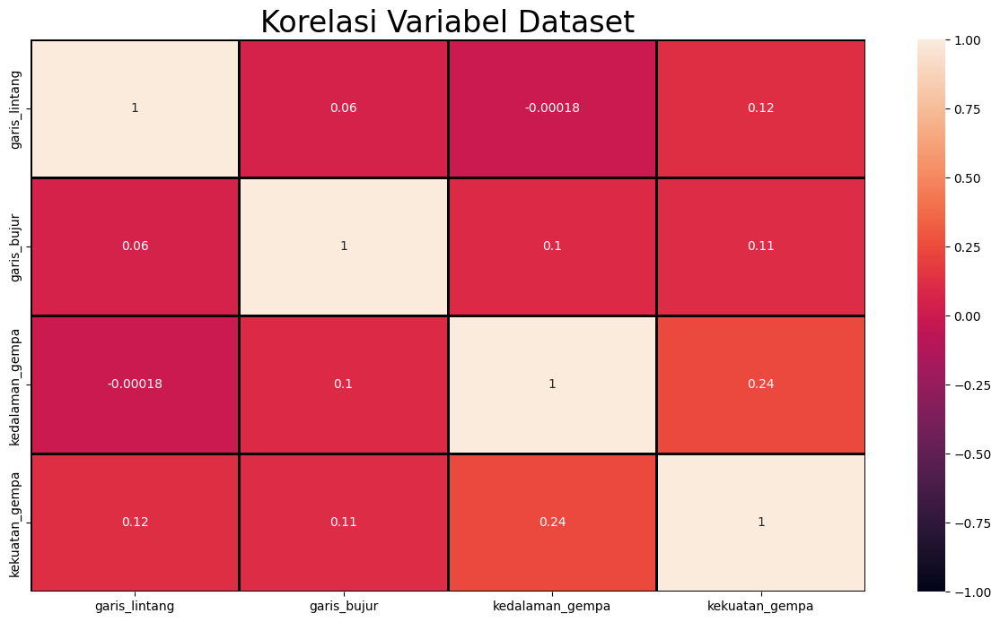

In [ ]:
#Korelasi Variabel Dataset
plt.figure(figsize=(15, 8))
correlation = sns.heatmap(data.corr(), vmin=-1, vmax=1, annot=True, linewidths=1, linecolor='black')
correlation.set_title('Korelasi Variabel Dataset', fontdict={'fontsize': 24})

In [ ]:
#memisahkan kolom waktu gempa menjadi dua kolom, tanggal dan waktu
data['tanggal'],data['waktu'] = zip(*[(d.date(), d.time()) for d in data['waktu_gempa']])

In [ ]:
data.head()

,waktu_gempa,garis_lintang,garis_bujur,kedalaman_gempa,kekuatan_gempa,lokasi_gempa,tanggal,waktu
0,2008-11-01 21:02:43.058,-9.18,119.06,10,4.9,Sumba Region - Indonesia,2008-11-01,21:02:43.058000
1,2008-11-01 20:58:50.248,-6.55,129.64,10,4.6,Banda Sea,2008-11-01,20:58:50.248000
2,2008-11-01 17:43:12.941,-7.01,106.63,121,3.7,Java - Indonesia,2008-11-01,17:43:12.941000
3,2008-11-01 16:24:14.755,-3.30,127.85,10,3.2,Seram - Indonesia,2008-11-01,16:24:14.755000
4,2008-11-01 16:20:37.327,-6.41,129.54,70,4.3,Banda Sea,2008-11-01,16:20:37.327000


In [ ]:
#membuat data baru
data0=data.fillna('N')
data1=data0[['tanggal','garis_lintang','garis_bujur','kedalaman_gempa','kekuatan_gempa']]
data1

,tanggal,garis_lintang,garis_bujur,kedalaman_gempa,kekuatan_gempa
0,2008-11-01,-9.18,119.06,10,4.9
1,2008-11-01,-6.55,129.64,10,4.6
2,2008-11-01,-7.01,106.63,121,3.7
3,2008-11-01,-3.30,127.85,10,3.2
4,2008-11-01,-6.41,129.54,70,4.3
...,...,...,...,...,...
92882,2023-01-26,3.24,127.18,10,4.0
92883,2023-01-26,2.70,127.10,10,3.9
92884,2023-01-26,-7.83,121.07,10,3.8
92885,2023-01-26,3.00,127.16,10,4.1


In [ ]:
data1['tanggal'] = pd.to_datetime(data1['tanggal'])

#membuat kolom bulan dan tahun
data1['tahun'] = data1['tanggal'].dt.year
data1['bulan'] = data1['tanggal'].dt.month
data1['bulan_dalam_tahun'] = data1['tanggal'].dt.to_period('M')

data1 = data1[['tanggal', 'tahun', 'bulan', 'bulan_dalam_tahun', 'garis_lintang','garis_bujur','kedalaman_gempa','kekuatan_gempa']]

In [ ]:
data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92887 entries, 0 to 92886
Data columns (total 8 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   tanggal            92887 non-null  datetime64[ns]
 1   tahun              92887 non-null  int64         
 2   bulan              92887 non-null  int64         
 3   bulan_dalam_tahun  92887 non-null  period[M]     
 4   garis_lintang      92887 non-null  float64       
 5   garis_bujur        92887 non-null  float64       
 6   kedalaman_gempa    92887 non-null  int64         
 7   kekuatan_gempa     92887 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(3), period[M](1)
memory usage: 5.7 MB


In [ ]:
#membuat data baru 2
data2=data1[['tanggal','kekuatan_gempa']]

data2

,tanggal,kekuatan_gempa
0,2008-11-01,4.9
1,2008-11-01,4.6
2,2008-11-01,3.7
3,2008-11-01,3.2
4,2008-11-01,4.3
...,...,...
92882,2023-01-26,4.0
92883,2023-01-26,3.9
92884,2023-01-26,3.8
92885,2023-01-26,4.1


<ipython-input-36-698140153345>:5: FutureWarning:

Passing unit-less datetime64 dtype to .astype is deprecated and will raise in a future version. Pass 'datetime64[ns]' instead



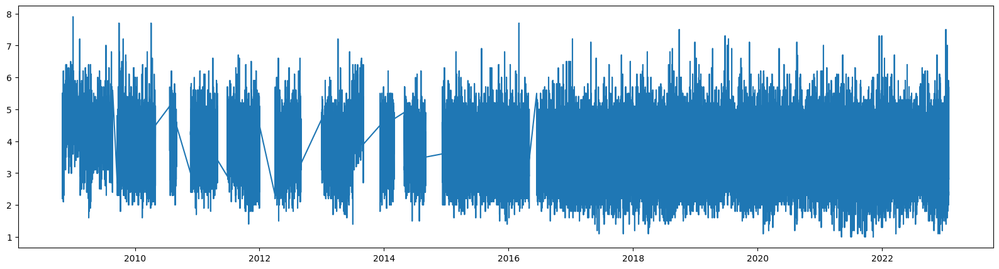

In [ ]:
item1=data2

item1.columns = ['ds','y']
item1.y = item1.y.astype('float')
item1.ds = item1.ds.astype('datetime64')

rcParams['figure.figsize'] = 20,5
plt.plot(item1.ds, item1.y)

## Model Prophet Forecasting

### Prediksi dan Fit Data Terdahulu

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpcd0_kg5f/s_y26s7q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpcd0_kg5f/s31k5dl2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=56939', 'data', 'file=/tmp/tmpcd0_kg5f/s_y26s7q.json', 'init=/tmp/tmpcd0_kg5f/s31k5dl2.json', 'output', 'file=/tmp/tmpcd0_kg5f/prophet_modelfrqgn4x8/prophet_model-20230615071711.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
07:17:11 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:18:14 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


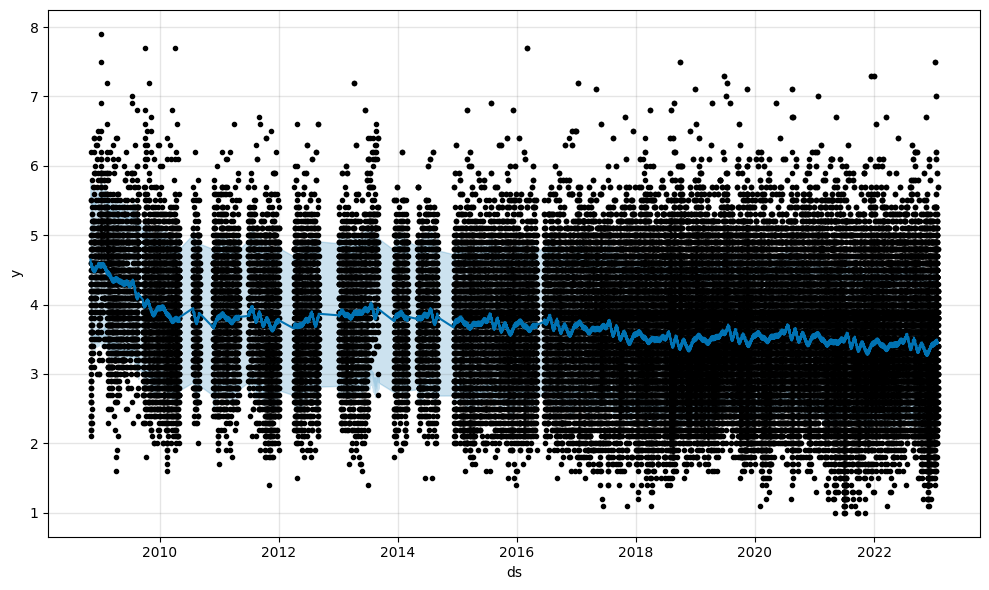

In [ ]:
ph = Prophet()
ph.fit(item1)
forecast1=ph.predict(item1)
figure = ph.plot(forecast1)
figure.show()

### Prediksi Data Terdahulu + Masa Depan dan Fit Data Terdahulu

In [ ]:
from datetime import timedelta
start0 = dt.datetime.strptime('2023-01-27', '%Y-%m-%d').date()
end0   = dt.datetime.strptime('2026-12-31', '%Y-%m-%d').date()
print((end0-start0).days)

1434


In [ ]:
def daterange(start,end):
    for i in range((end-start).days):
        return start+timedelta(i)

In [ ]:
dates0=[]
for i in range((end0-start0).days):
    dates0+=[(start0+timedelta(i)).strftime('%Y-%m-%d') ]
print(dates0[0:30])

['2023-01-27', '2023-01-28', '2023-01-29', '2023-01-30', '2023-01-31', '2023-02-01', '2023-02-02', '2023-02-03', '2023-02-04', '2023-02-05', '2023-02-06', '2023-02-07', '2023-02-08', '2023-02-09', '2023-02-10', '2023-02-11', '2023-02-12', '2023-02-13', '2023-02-14', '2023-02-15', '2023-02-16', '2023-02-17', '2023-02-18', '2023-02-19', '2023-02-20', '2023-02-21', '2023-02-22', '2023-02-23', '2023-02-24', '2023-02-25']


In [ ]:
dates0_df=pd.DataFrame(dates0)
dates0_df.columns=['ds']
dates0_df

,ds
0,2023-01-27
1,2023-01-28
2,2023-01-29
3,2023-01-30
4,2023-01-31
...,...
1429,2026-12-26
1430,2026-12-27
1431,2026-12-28
1432,2026-12-29


INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpcd0_kg5f/nyyxzbit.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpcd0_kg5f/06cnvd_w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19951', 'data', 'file=/tmp/tmpcd0_kg5f/nyyxzbit.json', 'init=/tmp/tmpcd0_kg5f/06cnvd_w.json', 'output', 'file=/tmp/tmpcd0_kg5f/prophet_modeli6qv7jvm/prophet_model-20230615071853.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
07:18:53 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:19:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


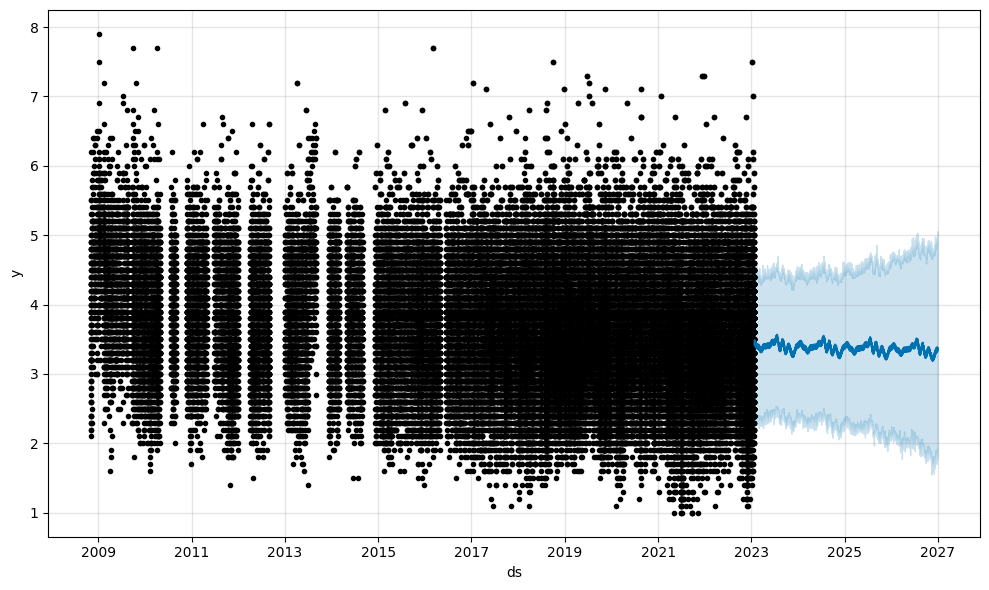

In [ ]:
ph = Prophet()
ph.fit(item1)
forecast3=ph.predict(dates0_df)
figure = ph.plot(forecast3)
figure.show()

In [ ]:
forecast3[['ds','yhat','yhat_lower','yhat_upper']][339:704]#['yhat'].max()

,ds,yhat,yhat_lower,yhat_upper
339,2024-01-01,3.382468,2.348391,4.438109
340,2024-01-02,3.405511,2.357129,4.418688
341,2024-01-03,3.423510,2.440144,4.457039
342,2024-01-04,3.402271,2.310559,4.449402
343,2024-01-05,3.385217,2.299403,4.378749
...,...,...,...,...
699,2024-12-26,3.376163,2.249661,4.494555
700,2024-12-27,3.358193,2.186949,4.504896
701,2024-12-28,3.422629,2.245839,4.479440
702,2024-12-29,3.401568,2.297860,4.514679


In [ ]:
forecast4=forecast3[['ds','yhat','yhat_lower','yhat_upper']][339:704*2]
forecast4.to_csv('forecast_kekuatan_gempa.csv')

### Prediksi Kekuatan Gempa Maksimum Selama Tahun 2024

In [ ]:
mag0=forecast3[339:1434*2]['yhat'].max()
print(mag0)

3.5500782099233503


In [ ]:
forecast3[forecast3['yhat']==mag0]

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
540,2024-07-20,3.379613,2.454969,4.703982,3.13149,3.625024,0.170465,0.170465,0.170465,0.035871,0.035871,0.035871,0.134593,0.134593,0.134593,0.0,0.0,0.0,3.550078


## Kesimpulan Analisis Prediksi

Berdasarkan hasil analisis dan prediksi dapat diambil kesimpulan bahwa:

* Jumlah gempa meningkat cukup drastis dari tahun 2008 hingga 2020, namun jumlah gempa yang terjadi pada tahun 2021 hingga 2023 cukup konstan.

* Rata-rata gempa yang terjadi pada tahun 2008 hingga 2023 berkekuatan 2 hingga 5 SR. Hanya sedikit gempa yang terjadi dengan SR 6 hingga 7 .

* Kedalaman gempa di Indonesia sebagian besar berkedalaman kurang dari 100 km

* Jumlah gempa bumi yang terjadi setiap tahun mengalami peningkatan yang cukup signifikan

* Jumlah lokasi yang sering terjadi gempa bumi yaitu Minahasa Peninsula, Sulawesi, Sumbawa, Jawa, Utara Pulau Sumatera, Selatan Pulau Sumatera , Laut Banda, Halmahera, Irian Jaya dan Selatan Pulau Jawa

* Kekuatan gempa terbesar terjadi pada tahun 2009 di Irian Jaya dengan kekuatan 7.9 SR dan gempa dengan kekuatan 7.7 SR yang terjadi pada tahun 2009 di Selatan Pulau Sumatera, tahun 2020 di Utara Pulau Sumatera serta tahun 2016  di Barat Daya Pulau Sulawesi

* Prediksi kekuatan gempa di Indonesia hingga tahun 2026 tidak lebih dari 5 skala richter

* Prediksi kekuatan gempa di Indonesia tertinggi selama 1 tahun yang akan datang pada tahun 2024 yaitu sebesar 3.6 skala richter